In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'anime-images:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F5847648%2F9588390%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20241011%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20241011T163852Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D3dcd07272aecd7656e8b7a4def080ef3b7f923386deb0931a54abe33625ecb11e84fd53f42dbbc74a913cbbcfcbe257de9f6c007565f56f87fd37df5fbf337445b02d26b0471999f9bfe62747c83e75f6a6131a0dab173aefa5a91e51567f245a03b697d33c88ae88d77bbfa507940f5851cee313ff350d873e21fbb5ee8a78eea824258bc37fe4a4744e9d036c3bb779d6bd400e04ed378976e8cc161599306e538049ed1872961f8246a5bb85c48c04fa6b57ed801d5f857579909b9dcdd8a800c95871efb968e41028a255de7d3c636b5a66d7321b567dc7364397405f0d798b996c574b1fdee15c49ccd0ed3d3a99259d7a071fd2db84dd67312eef63b6b'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


In [ ]:
!pip install torchsummary

from torch.utils.data import DataLoader, Dataset
import torchvision
from torchvision.datasets import ImageFolder
from torchvision.datasets import DatasetFolder
from PIL import Image
import torchvision.transforms as T
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline
import torch.nn as nn
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
from torchsummary import summary
import os

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [ ]:
DATA_DIR = '/kaggle/input/anime-images/images'
print(os.listdir(DATA_DIR)[:10])

['35715_2011.jpg', '48610_2014.jpg', '34719_2011.jpg', '40266_2012.jpg', '4199_2002.jpg', '40739_2013.jpg', '42515_2013.jpg', '52482_2015.jpg', '46555_2014.jpg', '11579_2005.jpg']


In [ ]:
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

Helper functions to denormalize the image tensors and display some sample images from a training batch.

In [ ]:
class AnimeDataset(Dataset):
    def __init__(self, root, transform=None):
        self.root = root
        self.transform = transform
        self.image_files = [f for f in os.listdir(root) if f.endswith(('.jpg', '.jpeg', '.png'))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root, self.image_files[idx])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, 0

image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

train_ds = AnimeDataset(DATA_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)
]))

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=3, pin_memory=True)

In [ ]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

In [ ]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

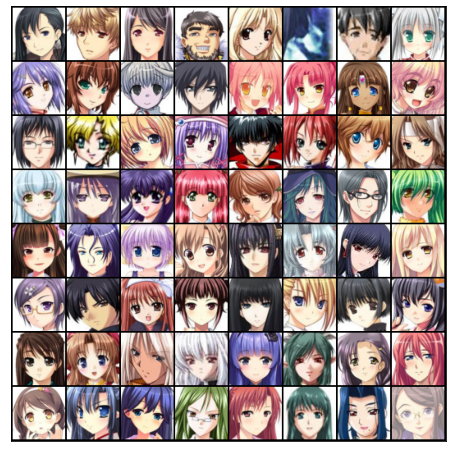

In [ ]:
show_batch(train_dl)

In [ ]:
def to_device(data, device):
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        return len(self.dl)

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
train_dl = DeviceDataLoader(train_dl, device)

In [ ]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())

In [ ]:
discriminator = to_device(discriminator, device)

In [ ]:
latent_size = 128

In [ ]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

torch.Size([128, 3, 64, 64])


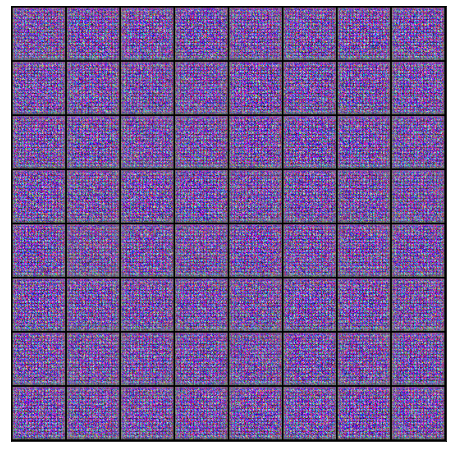

In [ ]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)

As one might expect, the output from the generator is basically random noise, since we haven't trained it yet.



In [ ]:
generator = to_device(generator, device)

In [ ]:
def train_discriminator(real_images, opt_d):
    opt_d.zero_grad()

    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()

    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [ ]:
def train_generator(opt_g):
    opt_g.zero_grad()

    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)

    loss.backward()
    opt_g.step()

    return loss.item()

In [ ]:
!pwd

/kaggle/working


In [ ]:
sample_dir = '/kaggle/working/generated'
os.makedirs(sample_dir, exist_ok=True)

In [ ]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

In [ ]:
def save_samples(epoch, latent, show=False, save_individual=False):
    with torch.no_grad():
        fake_images = generator(latent)
        fake_images = denorm(fake_images)

    img_grid = torchvision.utils.make_grid(fake_images, nrow=8).permute(1, 2, 0).detach().cpu().numpy()

    os.makedirs('./samples', exist_ok=True)

    plt.figure(figsize=(15, 15))
    plt.imshow(img_grid)
    plt.axis('off')
    plt.savefig(f'./samples/sample_{epoch}.png')

    if show:
        plt.show()
    else:
        plt.close()

    if save_individual:
        os.makedirs(f'./samples/epoch_{epoch}', exist_ok=True)
        for i, img in enumerate(fake_images):
            img_np = img.permute(1, 2, 0).detach().cpu().numpy()
            plt.figure(figsize=(10, 10))
            plt.imshow(img_np)
            plt.axis('off')
            plt.savefig(f'samples/epoch_{epoch}/image_{i}.png')
            plt.close()

In [ ]:
save_samples(0, fixed_latent)

In [ ]:
print("Generator Architecture:")
summary(generator, input_size=(latent_size, 1, 1))

print("Discriminator Architecture:")
summary(discriminator, input_size=(3, image_size, image_size))

Generator Architecture:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]       1,048,576
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Ta

In [ ]:
losses_g = []
losses_d = []
real_scores = []
fake_scores = []

def train(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()

    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            loss_g = train_generator(opt_g)

        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

        print(f"Epoch [{epoch+1}/{epochs}], loss_g: {loss_g:.4f}, loss_d: {loss_d:.4f}, "
              f"real_score: {real_score:.4f}, fake_score: {fake_score:.4f}")

        save_samples(epoch+start_idx, fixed_latent, show=True)

    save_samples(epochs+start_idx-1, fixed_latent, save_individual=True)

    if (epoch + 1) % 5 == 0:  # Save every 5 epochs
        torch.save({
            'generator': generator.state_dict(),
            'discriminator': discriminator.state_dict(),
            'opt_g': opt_g.state_dict(),
            'opt_d': opt_d.state_dict(),
        }, f'checkpoint_{epoch+1}.pt')

    return losses_g, losses_d, real_scores, fake_scores

In [ ]:
lr = 0.0002
epochs = 25


Epoch [1/25], loss_g: 6.6545, loss_d: 0.0321, real_score: 0.9798, fake_score: 0.0089


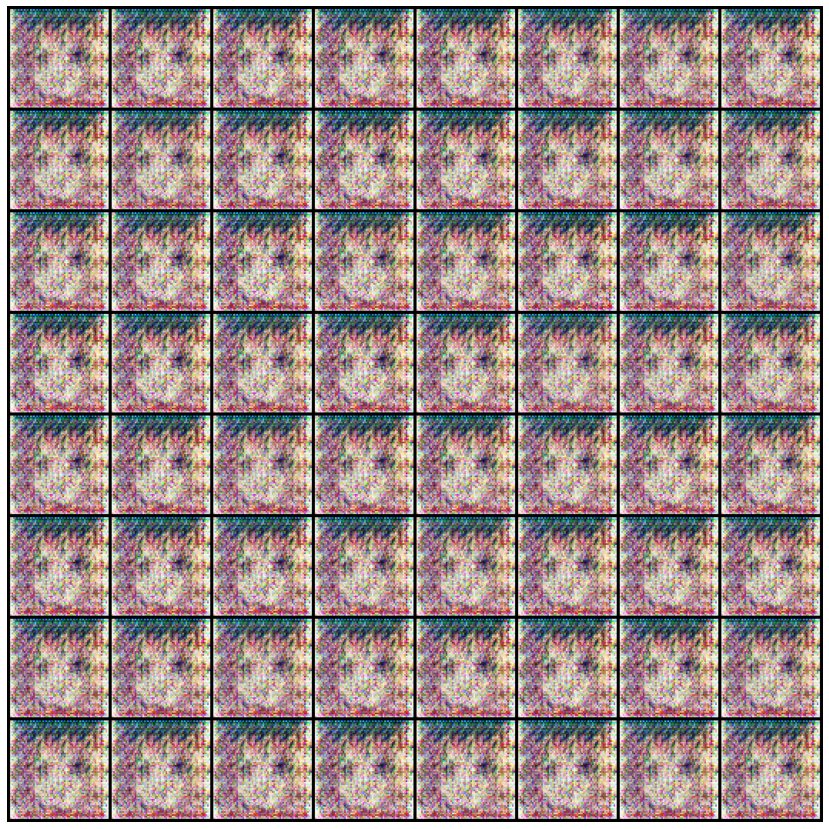


Epoch [2/25], loss_g: 7.0401, loss_d: 0.7366, real_score: 0.5911, fake_score: 0.0018


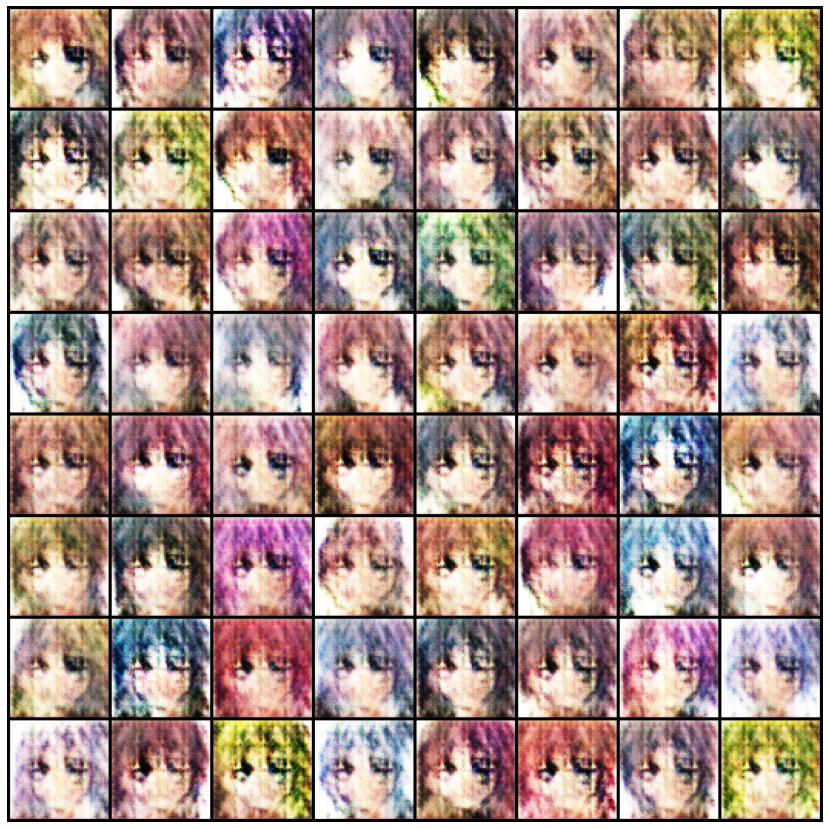


Epoch [3/25], loss_g: 9.1106, loss_d: 0.7337, real_score: 0.9579, fake_score: 0.4533


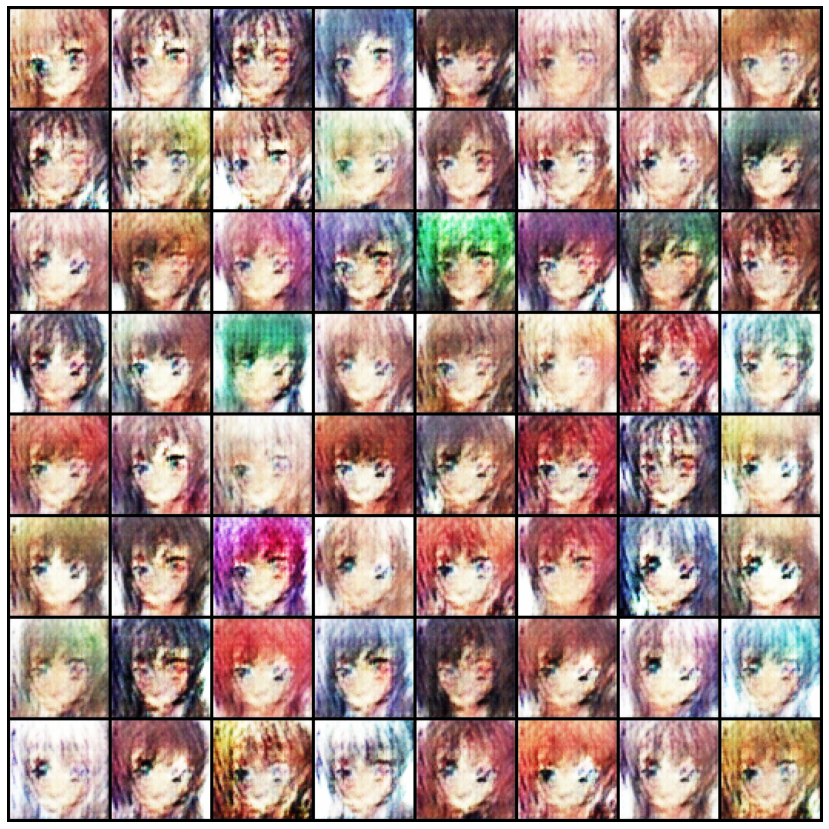


Epoch [4/25], loss_g: 5.1334, loss_d: 0.4287, real_score: 0.8186, fake_score: 0.1551


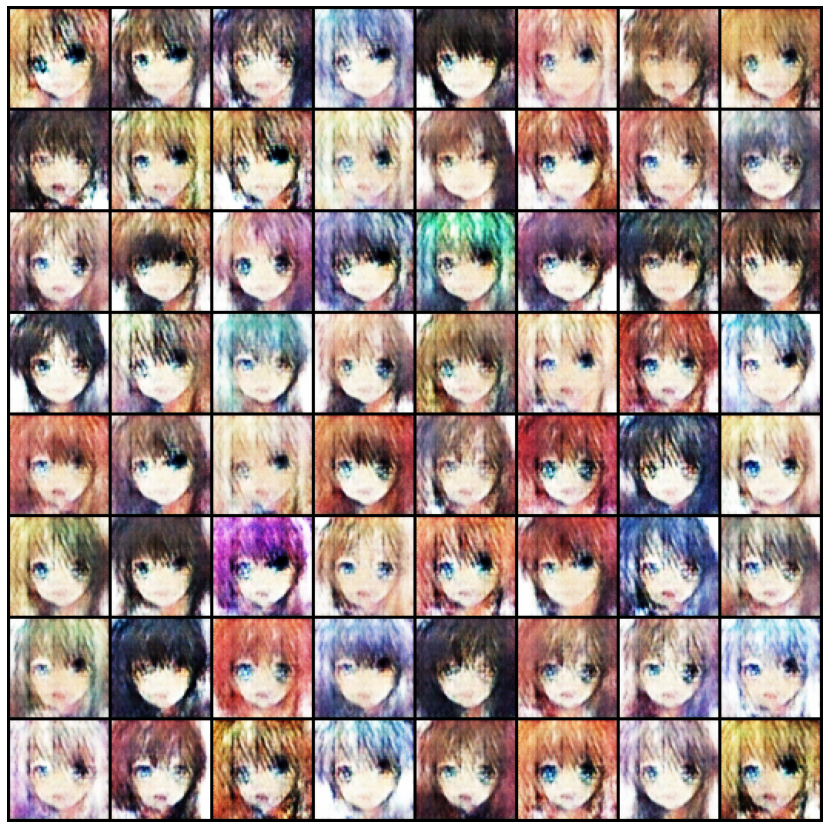


Epoch [5/25], loss_g: 8.5335, loss_d: 0.2700, real_score: 0.9960, fake_score: 0.2195


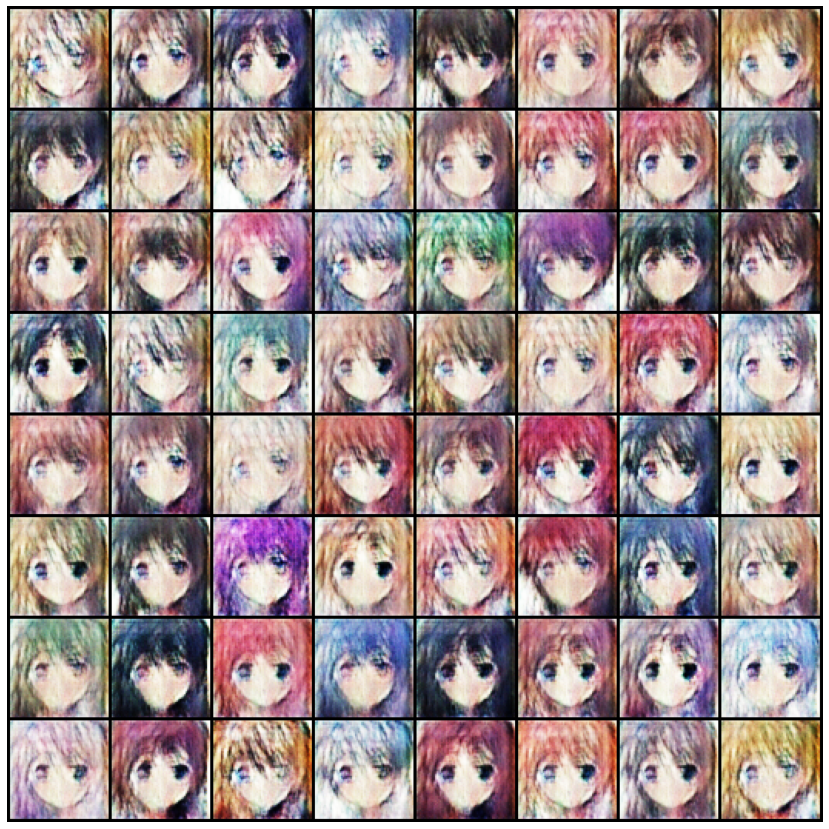


Epoch [6/25], loss_g: 6.4407, loss_d: 0.1900, real_score: 0.9549, fake_score: 0.1234


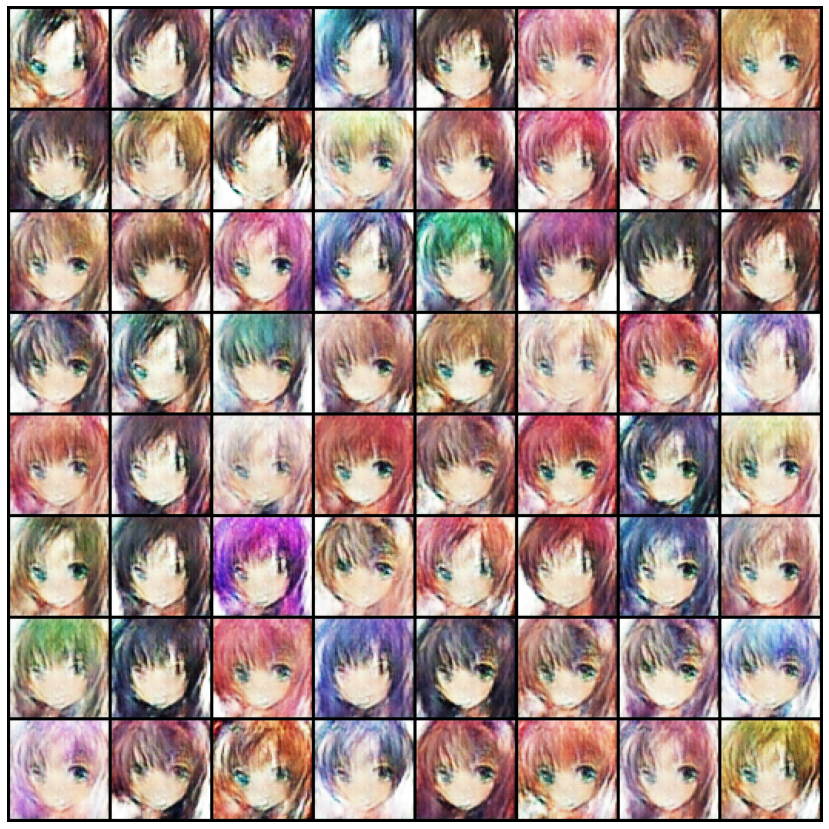


Epoch [7/25], loss_g: 8.9963, loss_d: 0.2527, real_score: 0.8193, fake_score: 0.0005


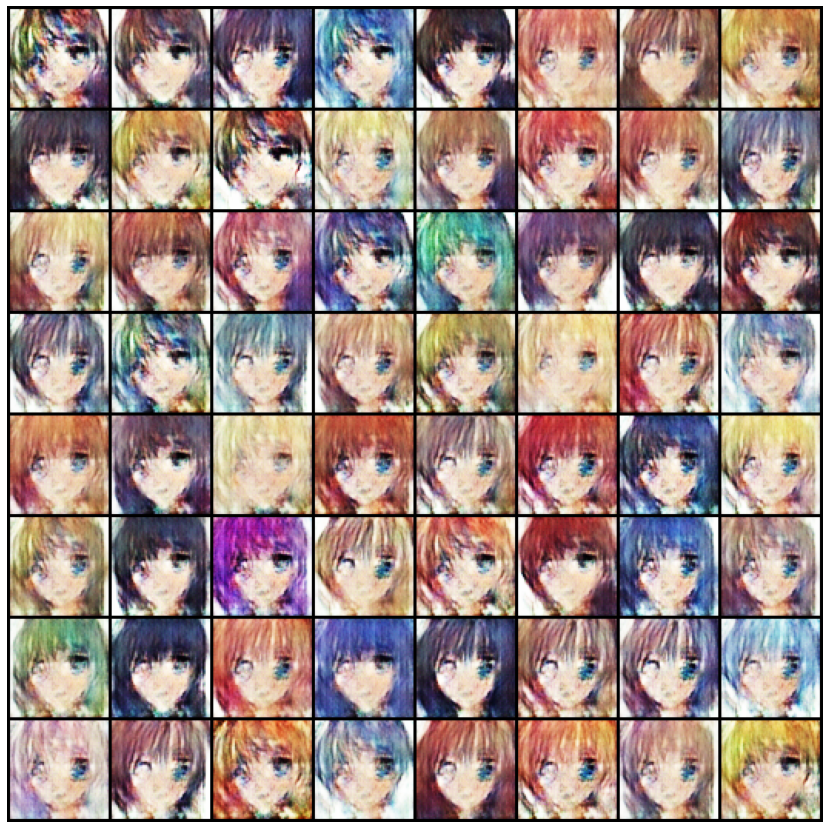


Epoch [8/25], loss_g: 9.4093, loss_d: 1.3181, real_score: 0.4284, fake_score: 0.0000


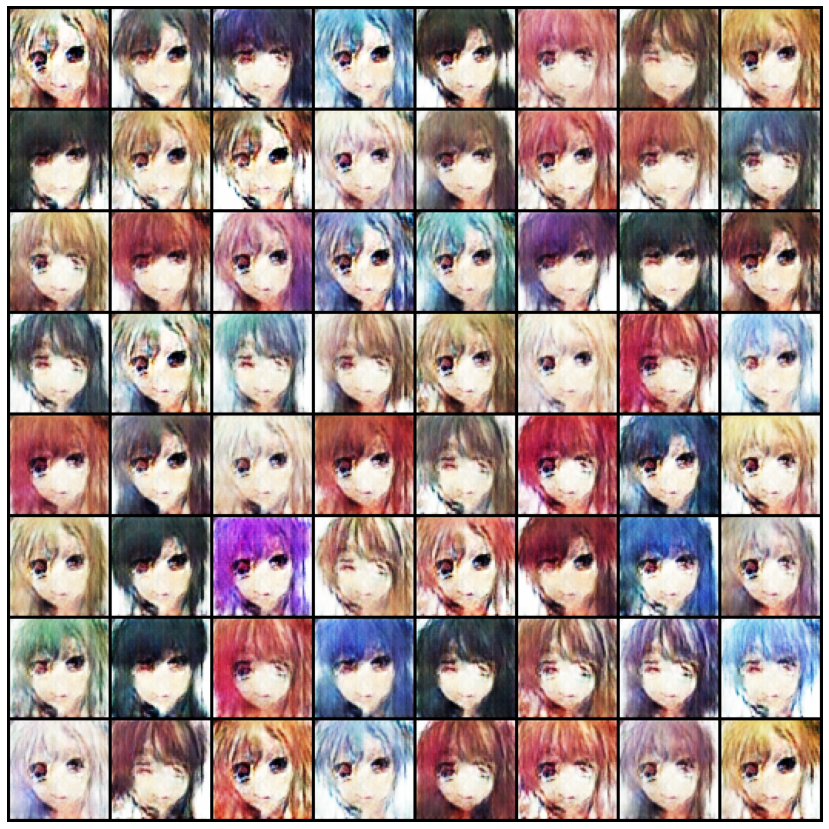


Epoch [9/25], loss_g: 9.5706, loss_d: 0.1496, real_score: 0.9785, fake_score: 0.1114


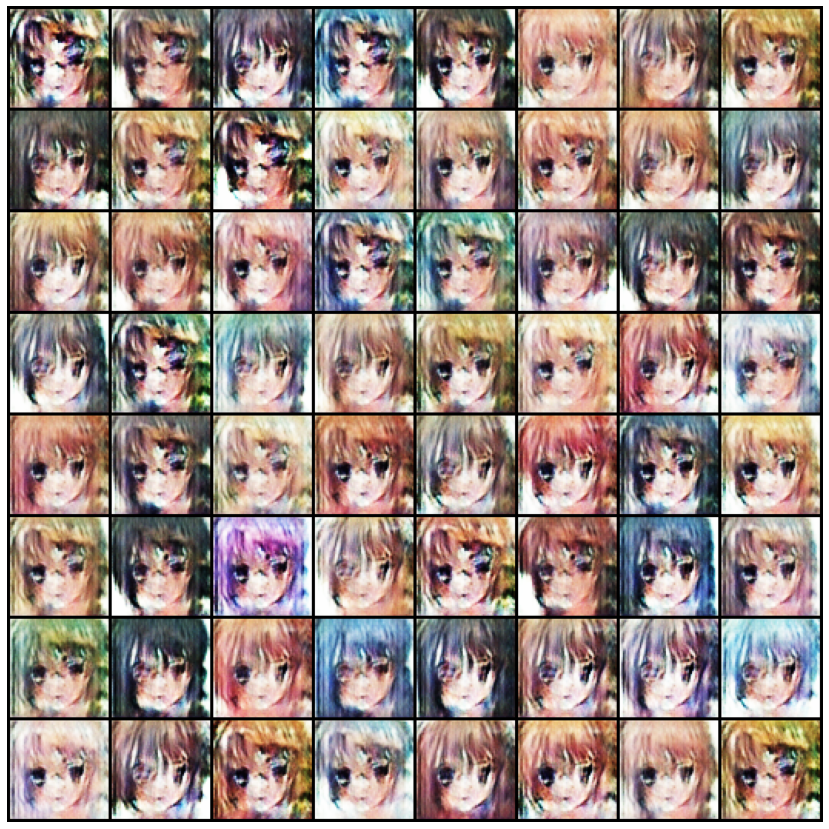


Epoch [10/25], loss_g: 11.6044, loss_d: 0.1492, real_score: 0.8892, fake_score: 0.0000


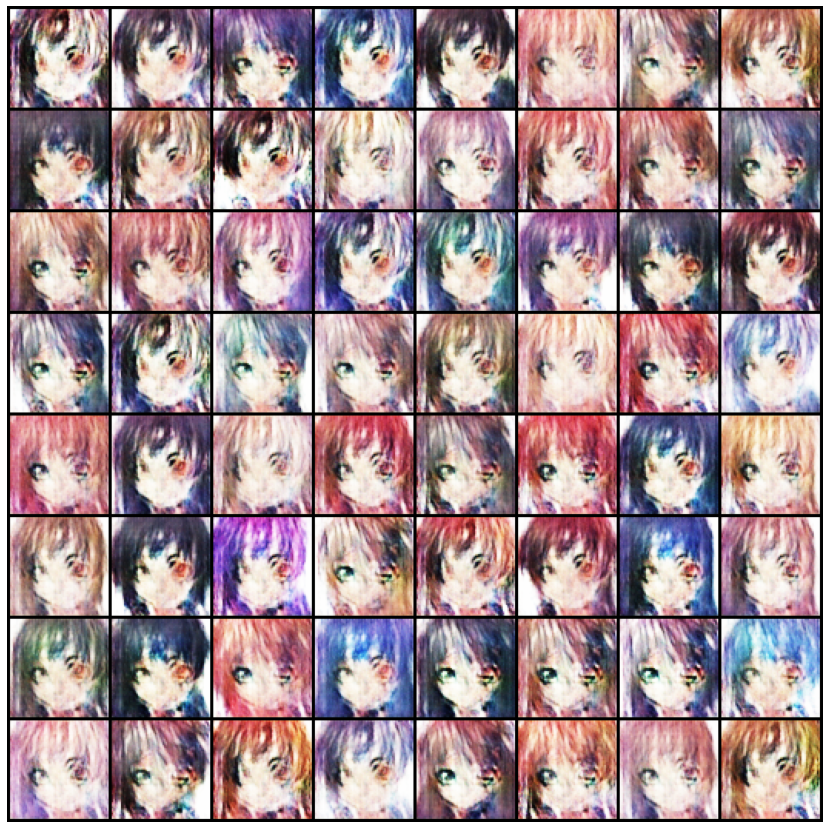


Epoch [11/25], loss_g: 7.7067, loss_d: 0.0672, real_score: 0.9528, fake_score: 0.0060


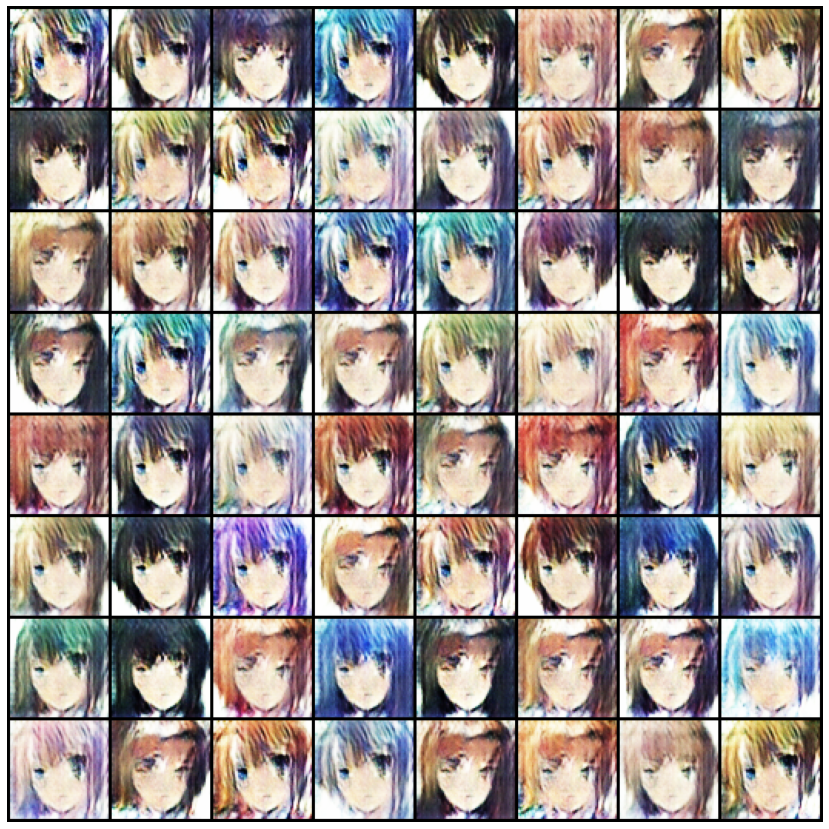


Epoch [12/25], loss_g: 8.3395, loss_d: 0.1402, real_score: 0.9647, fake_score: 0.0918


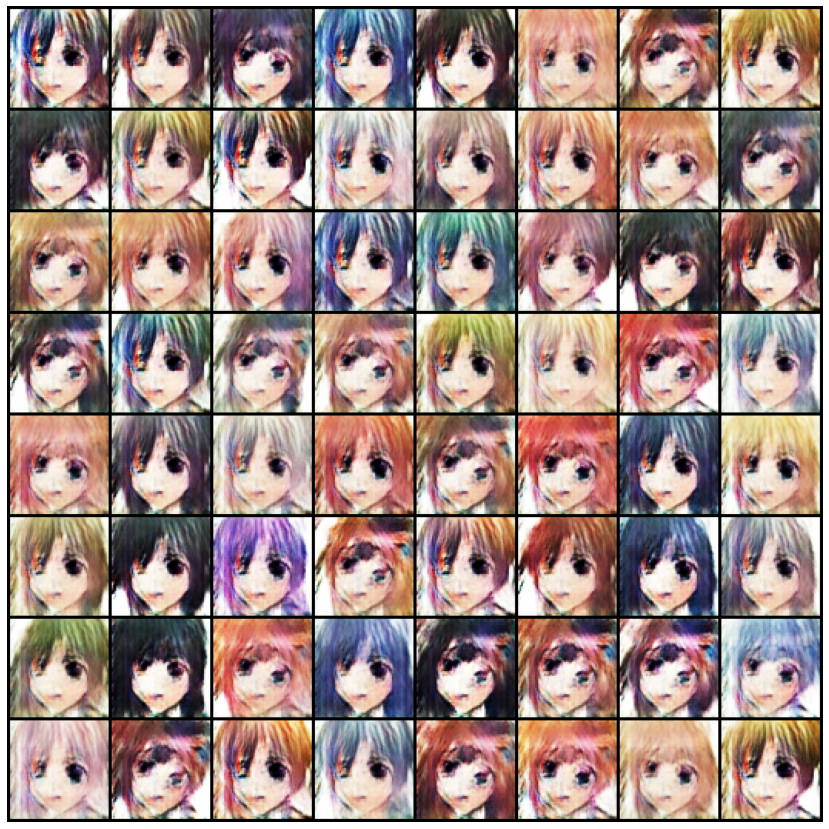


Epoch [13/25], loss_g: 5.9430, loss_d: 0.1412, real_score: 0.9103, fake_score: 0.0122


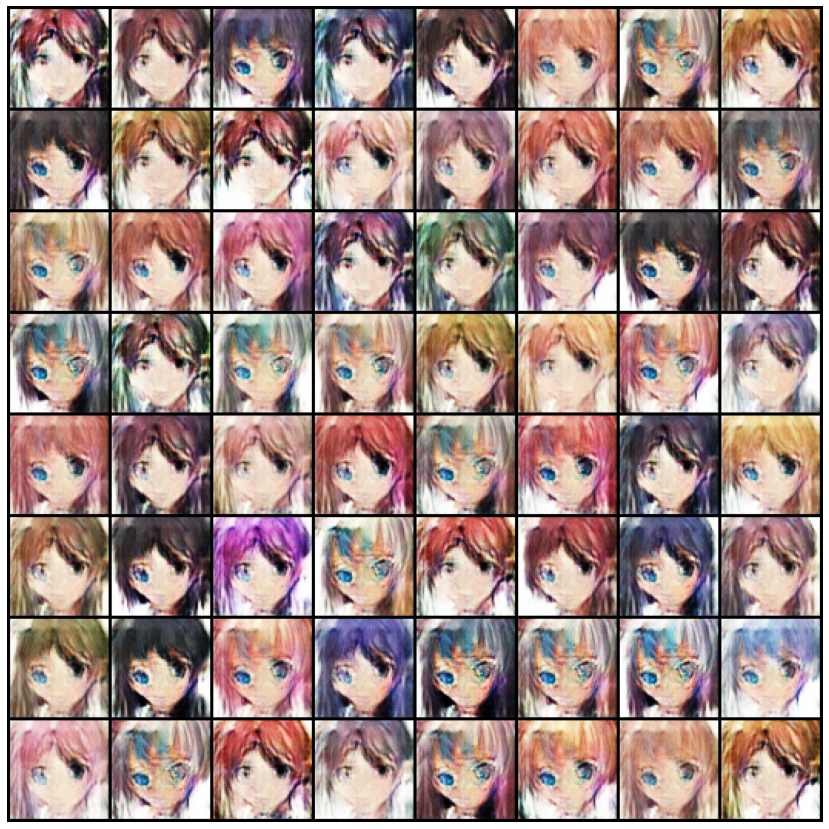


Epoch [14/25], loss_g: 9.9585, loss_d: 0.1338, real_score: 0.9790, fake_score: 0.0993


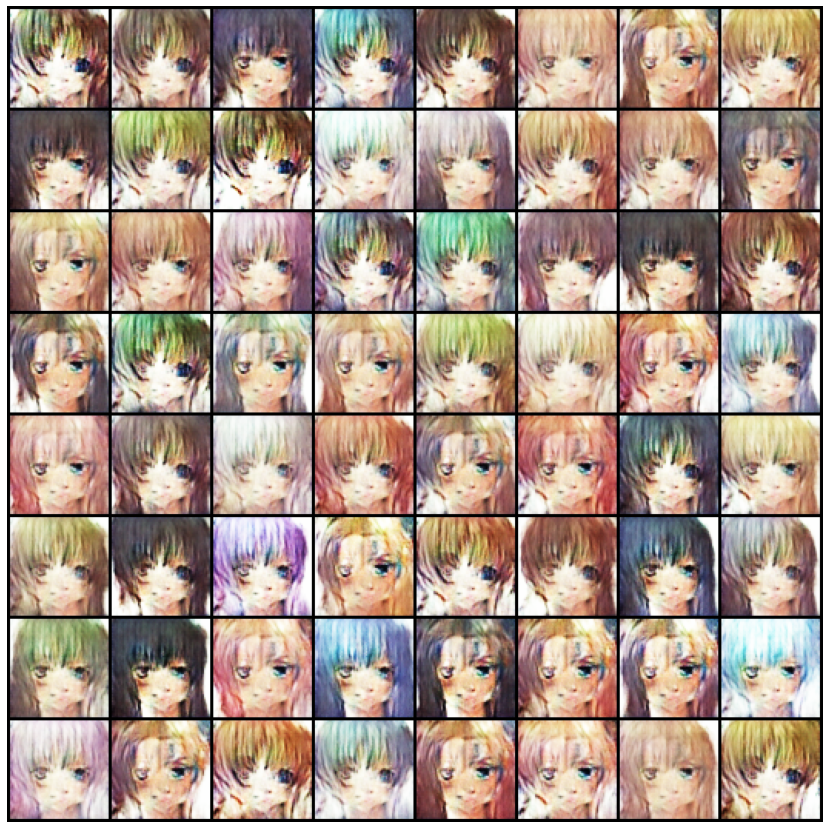


Epoch [15/25], loss_g: 10.6253, loss_d: 0.0602, real_score: 0.9559, fake_score: 0.0007


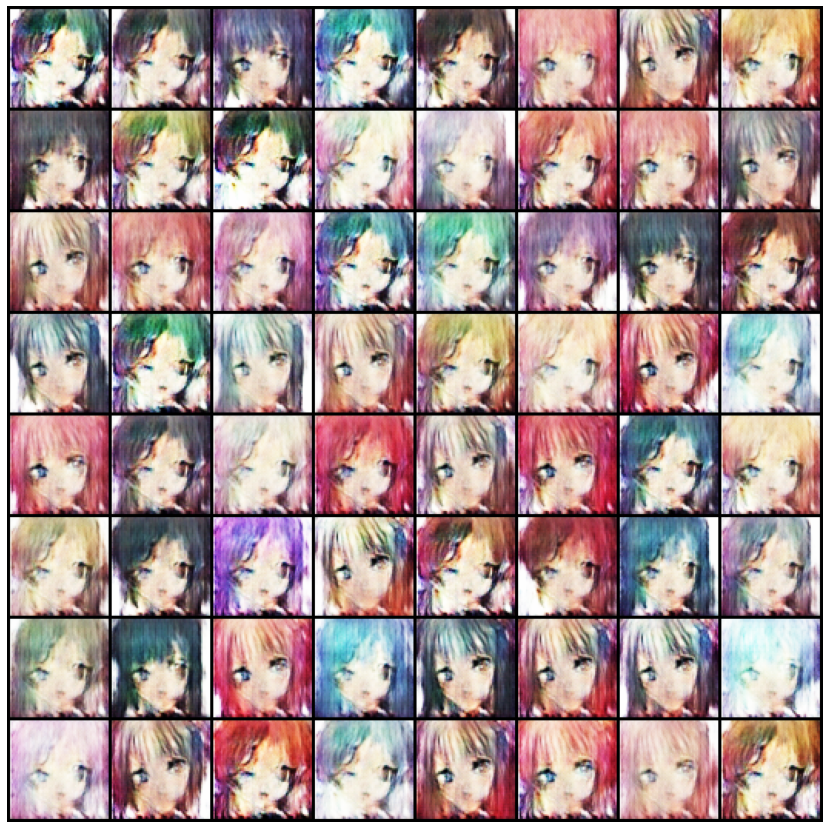


Epoch [16/25], loss_g: 5.0085, loss_d: 0.0614, real_score: 0.9513, fake_score: 0.0037


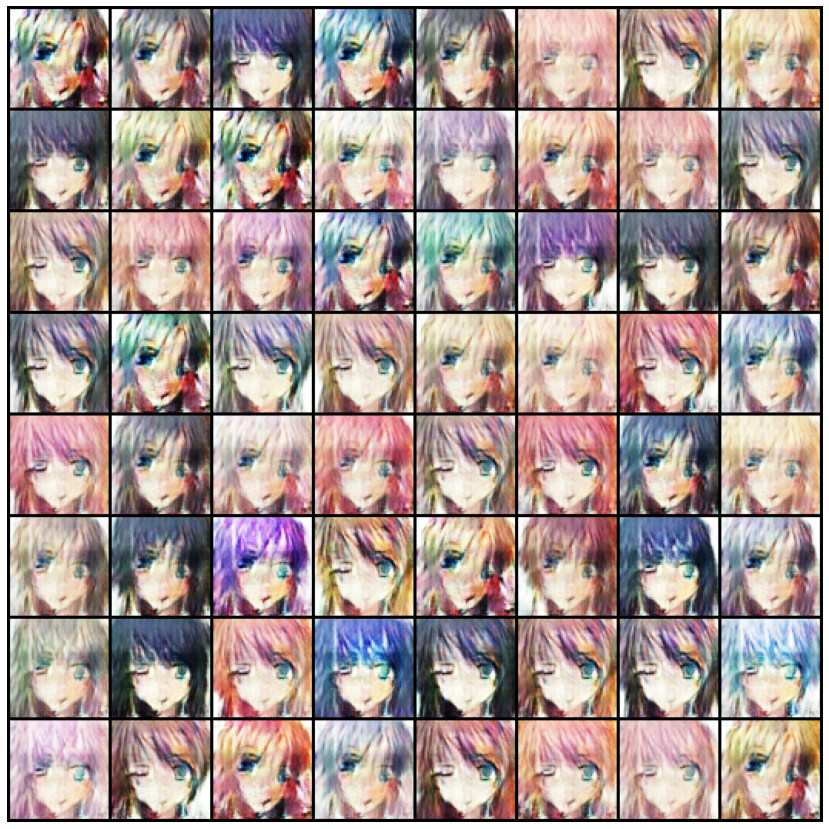


Epoch [17/25], loss_g: 6.6904, loss_d: 0.0997, real_score: 0.9725, fake_score: 0.0648


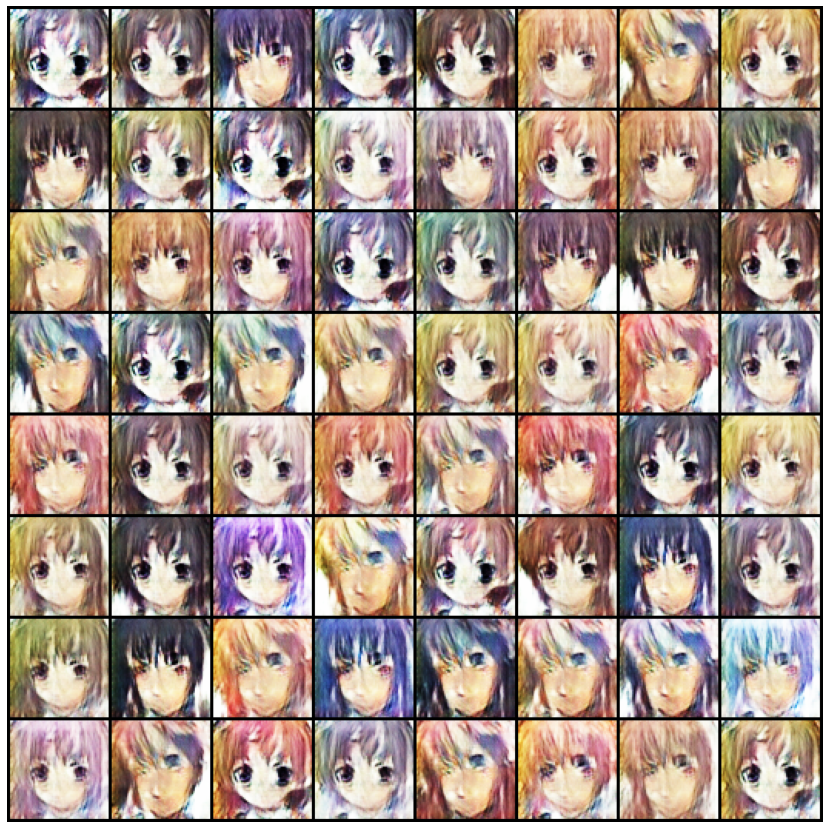


Epoch [18/25], loss_g: 16.6331, loss_d: 0.2509, real_score: 0.9876, fake_score: 0.1727


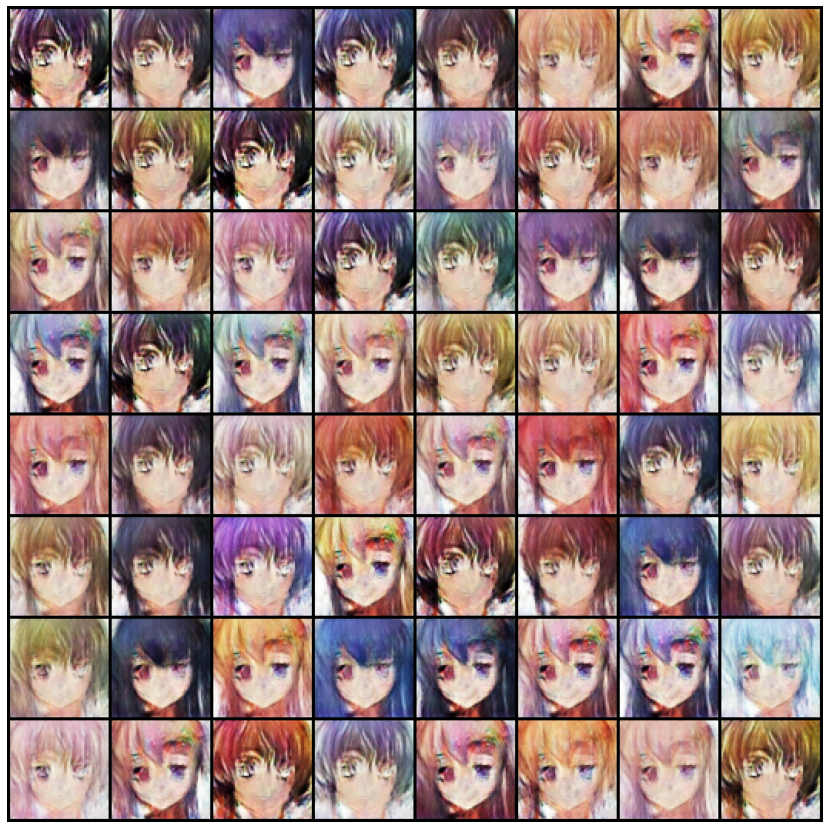


Epoch [19/25], loss_g: 12.2668, loss_d: 0.0479, real_score: 0.9679, fake_score: 0.0083


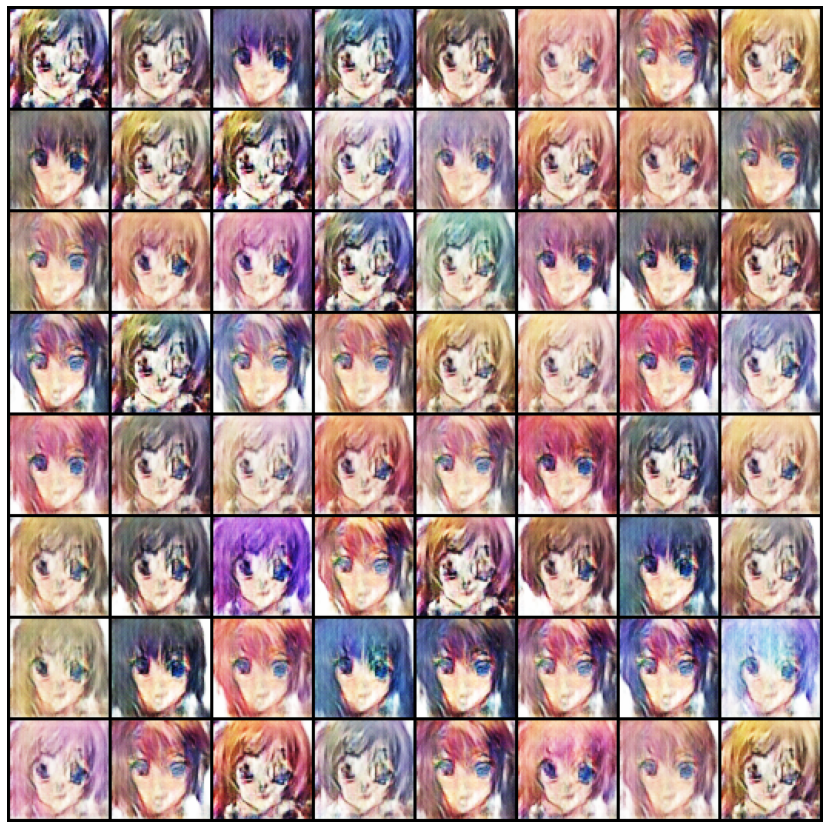


Epoch [20/25], loss_g: 5.1323, loss_d: 0.1294, real_score: 0.9328, fake_score: 0.0356


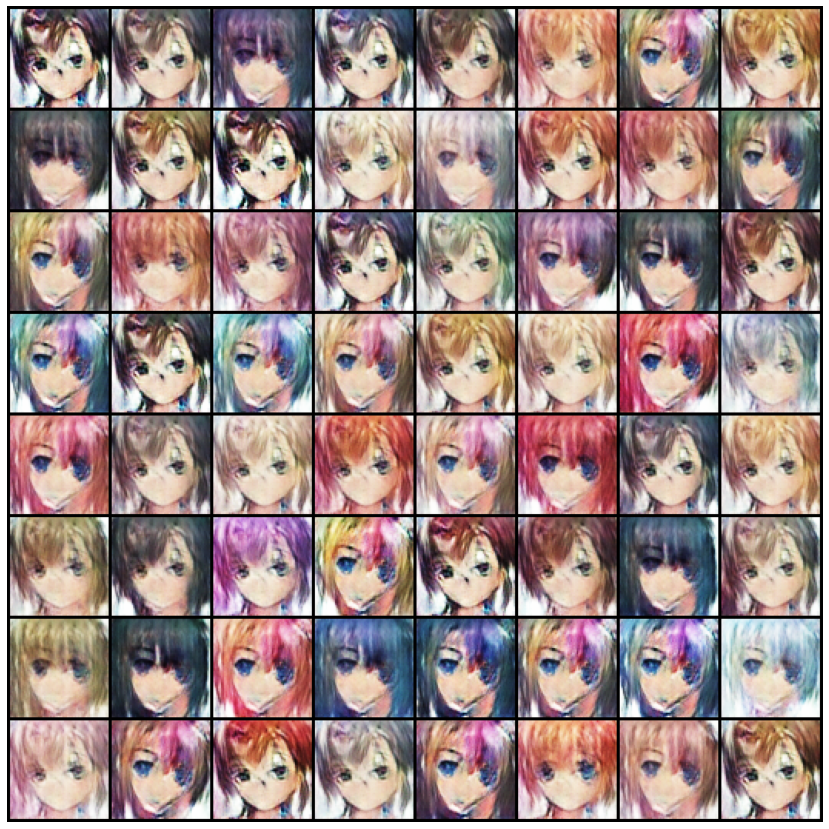


Epoch [21/25], loss_g: 6.6310, loss_d: 0.0796, real_score: 0.9766, fake_score: 0.0461


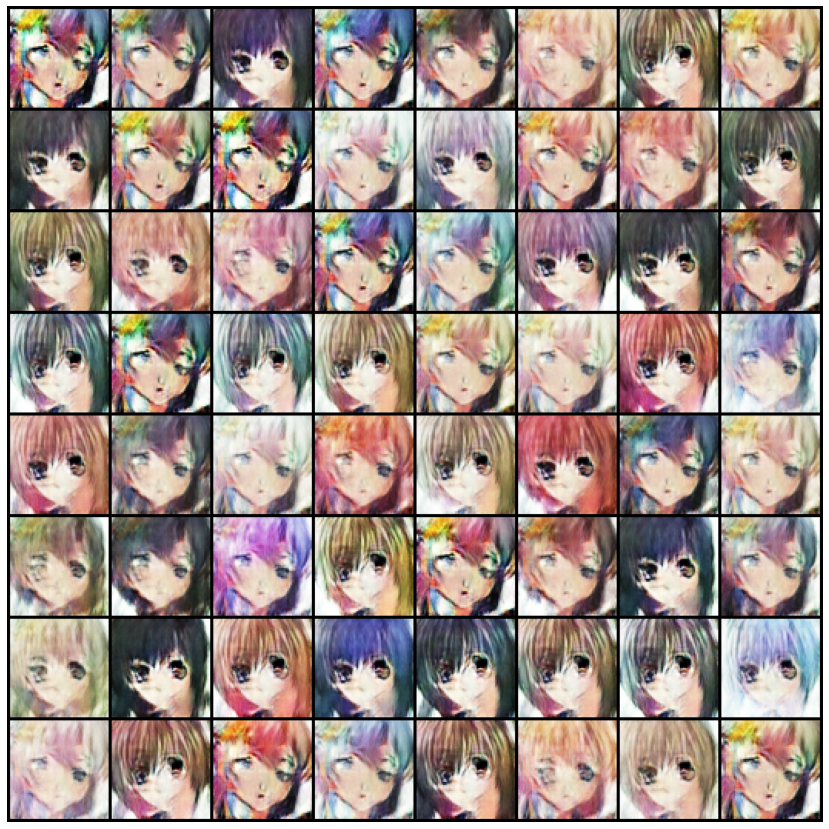


Epoch [22/25], loss_g: 20.0736, loss_d: 0.0969, real_score: 0.9632, fake_score: 0.0000


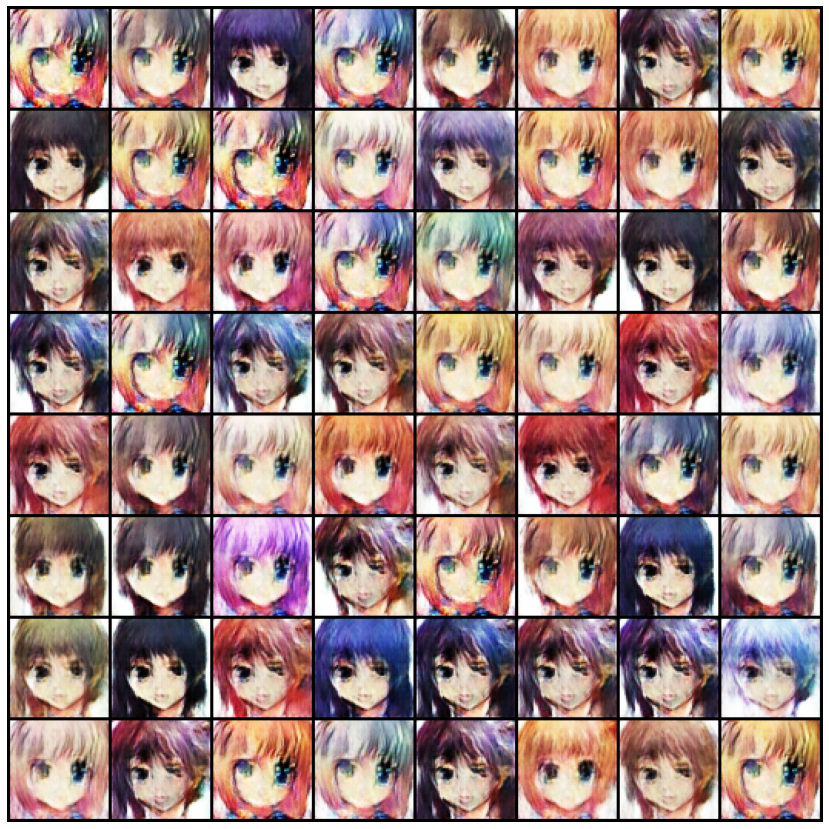


Epoch [23/25], loss_g: 9.8633, loss_d: 0.1077, real_score: 0.9966, fake_score: 0.0959


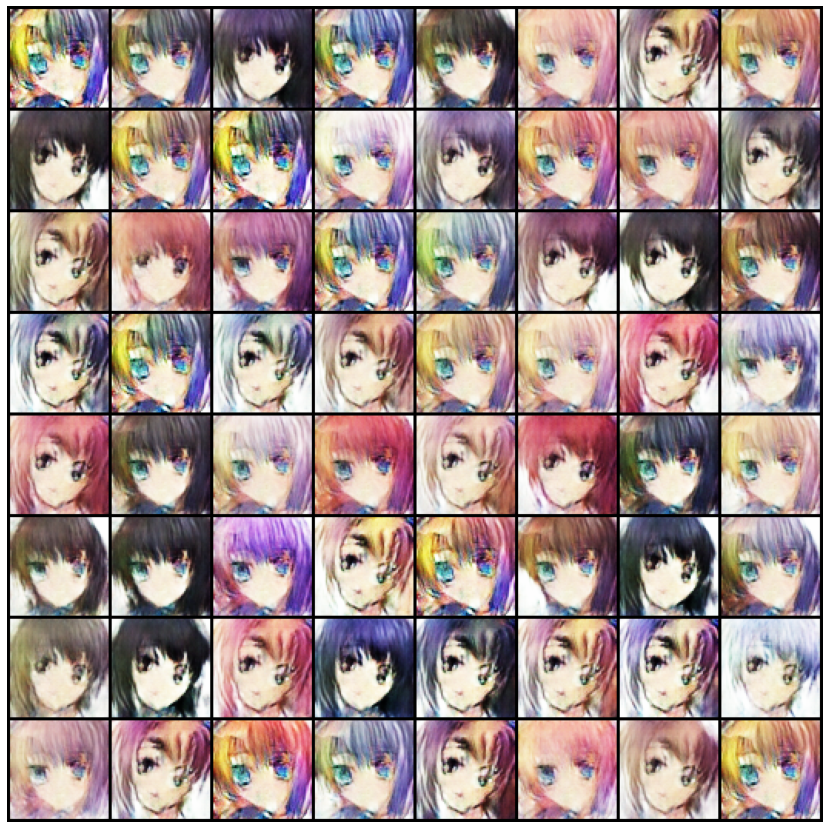


Epoch [24/25], loss_g: 5.7314, loss_d: 0.1490, real_score: 0.9115, fake_score: 0.0198


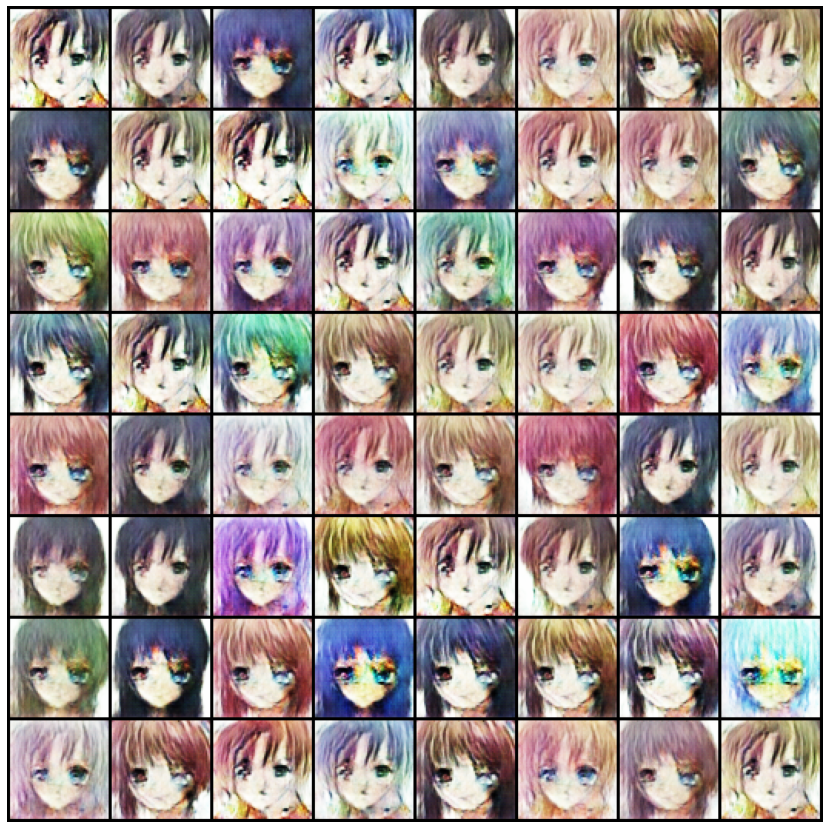


Epoch [25/25], loss_g: 9.2487, loss_d: 0.0901, real_score: 0.9796, fake_score: 0.0618


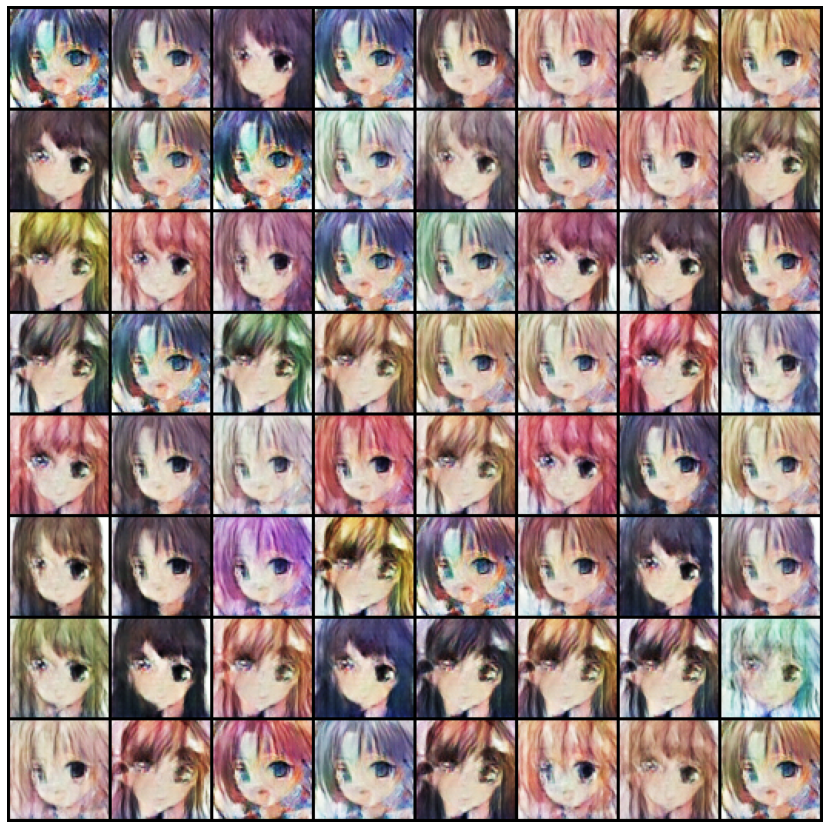

In [ ]:
history = train(epochs, lr)

In [ ]:
torch.save(generator.state_dict(), 'G.ckpt')
torch.save(discriminator.state_dict(), 'D.ckpt')

We can visualize the training process by combining the sample images generated after each epoch into a video using OpenCV.

In [ ]:
import cv2
import os

vid_fname = 'gans_training.mp4'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

out = cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'MP4V'), 1, (530,530))
[out.write(cv2.imread(fname)) for fname in files]
out.release()

In [ ]:
from IPython.display import Video

Video("gans_training.mp4", embed=True)

## Loss Visualizations (below text is taken from a blog, for personal reference)

Visualizing loss changes over time is key for debugging GAN training. We expect the generator's loss to decrease, while the discriminator's loss should remain moderate.

### What to Look For

1. **Loss Curves**
   - **Generator Loss:** Should generally decrease
   - **Discriminator Loss:** Ideally around 0.5-0.7.
     - **Too low (< 0.3):** Discriminator too strong.
     - **Too high (> 0.9):** Generator too strong.

2. **Scores**
   - **Real Scores:** Stabilize around 0.8-0.9.
   - **Fake Scores:** Stabilize around 0.1-0.2.
     - **Close scores:** Potential mode collapse.

3. **Image Quality**
   - Should improve over time.
   - Watch for:
     - Mode collapse (similar images)
     - Poor diversity
     - Artifacts/distortions

4. **Parameter Distributions**
   - Should change early and stabilize later.
   - Unusual patterns may indicate issues:
     - **All zeros:** Dead neurons.
     - **Extreme values:** Potential instability.

### Common Issues & Solutions

- **Mode Collapse:**
  - **Symptom:** Same images generated.
  - **Solution:** Adjust learning rates, batch size.

- **Discriminator Too Strong:**
  - **Symptom:** Generator loss increasing, discriminator loss near zero.
  - **Solution:** Reduce discriminator learning rate, add noise to labels.

- **Training Instability:**
  - **Symptom:** Fluctuating losses.
  - **Solution:** Reduce learning rates, try gradient penalty.

### Recommended Actions

- If generator loss isn’t decreasing:
  - Increase generator learning rate.
  - Decrease discriminator learning rate.

- If image quality plateaus:
  - Adjust architecture.
  - Consider progressive growing.

- If training is unstable:
  - Reduce learning rates.
  - Try different optimizers.
  - Add regularization.


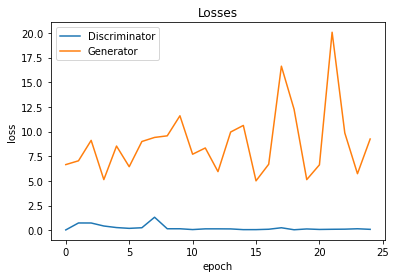

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

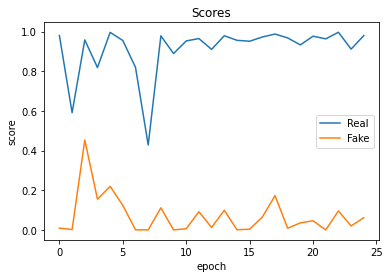

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

### Indications of a Normal-like Distribution

- **Balanced Learning:** Suggests effective learning in both generator and discriminator, preventing dominance by either model.
- **Stable Training:** Indicates stability in training dynamics, reducing issues like mode collapse and dead neurons.


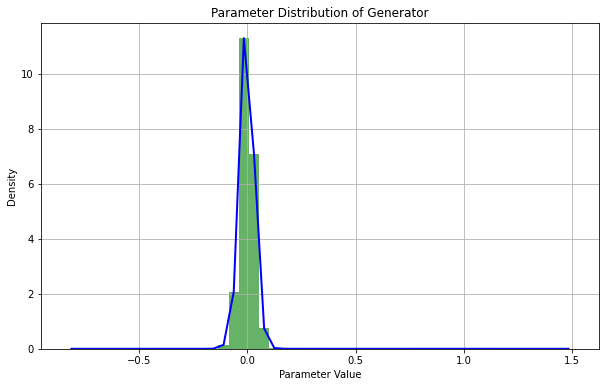

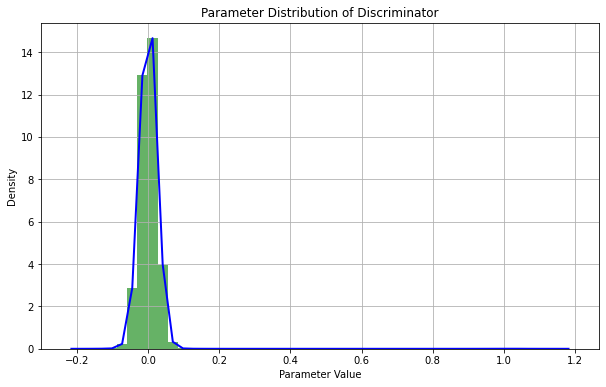

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_parameters(model, title):
    params = []
    for param in model.parameters():
        params.append(param.detach().cpu().numpy().flatten())  # Flatten and detach from the graph

    params = np.concatenate(params)

    plt.figure(figsize=(10, 6))
    plt.hist(params, bins=50, density=True, alpha=0.6, color='g')

    count, bins = np.histogram(params, bins=50, density=True)
    center = (bins[:-1] + bins[1:]) / 2  # Get the bin centers
    plt.plot(center, count, color='blue', linewidth=2)  # Plot the density line

    plt.title(f'Parameter Distribution of {title}')
    plt.xlabel('Parameter Value')
    plt.ylabel('Density')
    plt.grid()
    plt.show()

visualize_parameters(generator, "Generator")
visualize_parameters(discriminator, "Discriminator")


I've zipped the final generated images for download and applied ESRGAN to them in a separate notebook to address some compatibility issues with PyTorch.

Notebook for enhancing the resolution of the outputs:

In [ ]:
import shutil

folder_to_zip = '/kaggle/working/samples/epoch_25'
zip_file_name = '/kaggle/working/samples/epoch_25.zip'

shutil.make_archive(zip_file_name.replace('.zip', ''), 'zip', folder_to_zip)
print(f"Folder '{folder_to_zip}' zipped as '{zip_file_name}'")

Folder '/kaggle/working/samples/epoch_25' zipped as '/kaggle/working/samples/epoch_25.zip'
